In [1]:
import geopandas as gpd
import descartes
import pandas as pd
import os
from glob import glob
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import datetime
import numpy as np
import contextily as ctx

Read in shapefiles for census tracts (`atx`), elementary school catchments (`es`), 2015-16 [SABS survey](https://nces.ed.gov/programs/edge/SABS) (`sabs` which lacks Burnet and Austin ISD), and 2018 Census MSAs (`msas`):

In [2]:
data_dir = '../../data/'

In [3]:
def find_fp_with_atx(query: str) -> gpd.GeoDataFrame:
    """Find the census shp that contains 'large' MSAs like Austin.
    Should be 25 in TX"""
    for fp in glob(query):
        gdf = gpd.read_file(fp)
        # Austin MSA
        has_atx = gdf['NAME'].str.contains('Austin', case=False)
        if has_atx.any():
            print(fp)
            return gdf[has_atx]
    assert 0
    # assert gdfs, "query returned null"
    # return gpd.GeoDataFrame(pd.concat(gdfs))

In [4]:
find_fp_with_atx(os.path.join(data_dir, '2018_msas/*.shp'))

../../data/2018_msas/cb_2018_us_cbsa_5m.shp


,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry
266,None,12420,310M400US12420,12420,"Austin-Round Rock, TX",M1,10933857595,151507606,"POLYGON ((-98.17298 30.35631, -98.12556 30.426..."
435,462,12380,310M400US12380,12380,"Austin, MN",M2,1842332264,617233,"POLYGON ((-93.04952 43.84844, -93.04597 43.848..."


Let's try looking only at CBSAs:

In [5]:
atx_ct_shp = gpd.read_file(os.path.join(data_dir, '2020_texas_census_tracts/2020_texas_census_tracts.shp'))
es_shp = gpd.read_file(os.path.join(data_dir, 'aisd_shapefiles/20_21_elem_updt_v2.shp'))
sabs_shp = gpd.read_file(os.path.join(data_dir, 'SABS_1516_SchoolLevels/SABS_1516_Primary.shp'))

In [6]:
msa_query = os.path.join(data_dir, '2018_msas/*cbsa*.shp')

In [7]:
def get_msas(query: str) -> gpd.GeoDataFrame:
    """Concatenates all GDFs in glob `query`"""
    gdfs = [gpd.read_file(fp) for fp in glob(query)]
    assert gdfs, "query returned null"
    return gpd.GeoDataFrame(pd.concat(gdfs))

In [8]:
msas_shp = get_msas(msa_query)

Filter out the other 49 states in SABS and MSA for the sake of memory and convenience:

In [9]:
sabs_shp = sabs_shp[sabs_shp['stAbbrev'] == 'TX']
tx_msas = msas_shp[msas_shp['NAME'].str.contains('TX', case=False)]
print(f"shape of MSAs GDF: {tx_msas.shape}")

shape of MSAs GDF: (207, 9)


In [10]:
print(
    tx_msas['NAME'].unique(),
    len(tx_msas['NAME'].unique()))

['Borger, TX' 'Kerrville, TX' 'Plainview, TX' 'Sweetwater, TX' 'Waco, TX'
 'Sulphur Springs, TX' 'Big Spring, TX' 'Snyder, TX' 'Odessa, TX'
 'Abilene, TX' 'San Antonio-New Braunfels, TX' 'Texarkana, TX-AR'
 'Lubbock, TX' 'Amarillo, TX' 'Brownwood, TX' 'Dumas, TX'
 'Port Lavaca, TX' 'Lamesa, TX' 'Uvalde, TX' 'Stephenville, TX'
 'El Campo, TX' 'Wichita Falls, TX' 'Midland, TX' 'Pampa, TX'
 'San Angelo, TX' 'Levelland, TX' 'Houston-The Woodlands-Sugar Land, TX'
 'Andrews, TX' 'Killeen-Temple, TX' 'Brenham, TX' 'Austin-Round Rock, TX'
 'Beaumont-Port Arthur, TX' 'Marshall, TX' 'McAllen-Edinburg-Mission, TX'
 'Sherman-Denison, TX' 'Lufkin, TX' 'Kingsville, TX' 'Eagle Pass, TX'
 'Victoria, TX' 'Mount Pleasant, TX' 'Bay City, TX' 'Rio Grande City, TX'
 'Nacogdoches, TX' 'Corsicana, TX' 'Jacksonville, TX' 'Mineral Wells, TX'
 'El Paso, TX' 'Fredericksburg, TX' 'Beeville, TX' 'Bonham, TX'
 'Hereford, TX' 'Alice, TX' 'Pecos, TX' 'Del Rio, TX' 'Tyler, TX'
 'College Station-Bryan, TX' 'Dallas-Fort

25 metropolitan statistical areas, 44 micropolitan statistical areas in TX = 69 total

While it's nice to have the filtering for TX MSAs (productionizing in future), we really only need the Austin-Round Rock-San Marcos MSA for this notebook.

In [11]:
atx_msas = tx_msas[tx_msas['NAME'].str.contains('Austin', case=False)]
atx_msas

,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry
266,None,12420,310M400US12420,12420,"Austin-Round Rock, TX",M1,10933857595,151507606,"POLYGON ((-98.17298 30.35631, -98.12556 30.426..."
404,None,12420,310M400US12420,12420,"Austin-Round Rock, TX",M1,10933857595,151507606,"POLYGON ((-98.29417 30.04680, -98.28706 30.065..."
385,None,12420,310M400US12420,12420,"Austin-Round Rock, TX",M1,10933857595,151507606,"POLYGON ((-98.17298 30.35631, -98.12556 30.426..."


Ensure coordinate reference systems (CRS) match. Census tract and AISD shapefiles use NAD83, and SABS is in Open Street Maps (OSM) CRS

In [12]:
print(atx_ct_shp.crs.name)
print(es_shp.crs.name)
print(sabs_shp.crs.name)
print(atx_msas.crs.name)

NAD83
NAD83
WGS 84 / Pseudo-Mercator
NAD83


Let's convert to the OSM CRS:

In [13]:
atx_shp_osm = atx_ct_shp.to_crs({'init': 'EPSG:3857'})
es_shp_osm = es_shp.to_crs({'init': 'EPSG:3857'})
msa_shp_osm = atx_msas.to_crs({'init': 'EPSG:3857'})
sabs_shp_osm = sabs_shp

/Users/TASethanho/anaconda3/envs/geopandas/lib/python3.9/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [14]:
assert atx_shp_osm.crs == es_shp_osm.crs == sabs_shp_osm.crs == msa_shp_osm.crs

## Visualize Shapefiles
Just to get an idea of what we're looking at. 

In [15]:
sabs_shp_osm.head()

,SrcName,ncessch,schnam,leaid,gslo,gshi,defacto,stAbbrev,openEnroll,Shape_Leng,Shape_Area,level,MultiBdy,geometry
36034,None,480000101145,CROSBYTON EL,4800001,PK,05,1,TX,0,231164.650104,1.768275e+09,1,0,"POLYGON ((-11281346.371 3987964.176, -11281343..."
36035,None,480000600274,ASPERMONT EL,4800006,PK,05,1,TX,0,246901.962200,3.005729e+09,1,0,"POLYGON ((-11189642.460 3898709.547, -11189638..."
36036,Dripping Springs,480000801507,DRIPPING SPRINGS EL,4800008,PK,05,0,TX,0,109636.791042,2.125308e+08,1,0,"MULTIPOLYGON (((-10922523.357 3551547.378, -10..."
36037,Walnut Springs,480000806989,WALNUT SPRINGS EL,4800008,PK,05,0,TX,0,159876.915178,4.116677e+08,1,0,"POLYGON ((-10926141.469 3546621.811, -10925182..."
36038,Rooster Springs,480000811280,ROOSTER SPRINGS EL,4800008,PK,05,0,TX,0,42288.398204,5.389171e+07,1,0,"POLYGON ((-10901471.558 3526669.331, -10901437..."


In [16]:
es_shp_osm.head()

,ISD,CAMPUS,SCHL_YEAR,ELEM_NAME,CAMPUS_ID,ALT_PK,geometry
0,AUSTIN ISD,ALLISON ELEM,2020-21,ALLISON,101,None,"POLYGON ((-10874723.564 3534720.499, -10874712..."
1,AUSTIN ISD,ANDREWS ELEM,2020-21,ANDREWS,102,None,"POLYGON ((-10873791.272 3544072.561, -10873793..."
2,AUSTIN ISD,BALDWIN ELEM,2020-21,BALDWIN,187,None,"MULTIPOLYGON (((-10900697.518 3540432.910, -10..."
3,AUSTIN ISD,BARANOFF ELEM,2020-21,BARANOFF,182,MENCHACA,"MULTIPOLYGON (((-10895217.316 3526843.651, -10..."
4,AUSTIN ISD,BARRINGTON ELEM,2020-21,BARRINGTON,149,None,"POLYGON ((-10874594.131 3549678.828, -10874585..."


In [17]:
atx_shp_osm.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,48,189,950200,48189950200,9502,Census Tract 9502,G5020,S,6306913.0,0.0,+34.2117433,-101.7172438,"POLYGON ((-11325148.156 4057103.568, -11325147..."
1,48,219,950400,48219950400,9504,Census Tract 9504,G5020,S,12691656.0,5302.0,+33.5889072,-102.3953070,"POLYGON ((-11400914.838 3971200.876, -11400914..."
2,48,219,950300,48219950300,9503,Census Tract 9503,G5020,S,12186639.0,0.0,+33.5869355,-102.3416971,"POLYGON ((-11395512.062 3973076.810, -11395512..."
3,48,219,950100,48219950100,9501,Census Tract 9501,G5020,S,214157569.0,0.0,+33.7715552,-102.1822653,"POLYGON ((-11385971.861 3991815.397, -11385969..."
4,48,219,950600,48219950600,9506,Census Tract 9506,G5020,S,358638163.0,0.0,+33.4659916,-102.1861385,"POLYGON ((-11390017.136 3949860.960, -11389762..."


<AxesSubplot:>

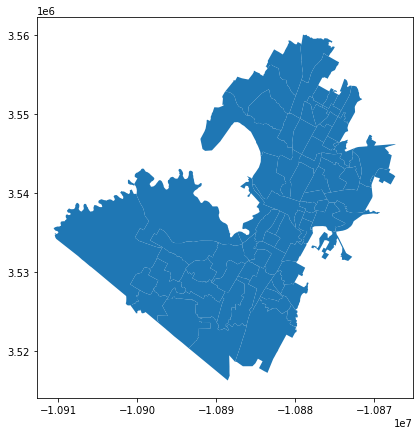

In [18]:
es_shp_osm.plot(figsize=(10, 7))

## Filter `atx`, `es`, `sabs` to Austin MSA
Only look at polygons that intersect the Austin MSA. For example, with elementary school catchments (`es`):


<AxesSubplot:>

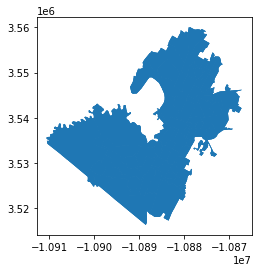

In [19]:
gpd.overlay(es_shp_osm, msa_shp_osm, how="intersection").plot()

Pretty obvious that all Austin catchments are in the MSA. This operation is important for filtering SABS ISDs that are:
- Not the missing ISDs (Burnet and Austin)
- Intersecting the MSA

Is column `ncessch` a good, unique primary key to use for filtering?

In [20]:
sabs_shp_osm.shape

(3719, 14)

In [21]:
sabs_shp_osm['ncessch'].unique().shape

(3719,)

Get `ncessch` in the SABS gdf that intersect with Austin MSA.

In [22]:
ix_keys = gpd.overlay(sabs_shp_osm, msa_shp_osm, how="intersection")['ncessch'].unique()
ix_keys

array(['480000801507', '480000806989', '480000811280', '480000905246',
       '480000906499', '480001005245', '480001006346', '480001007343',
       '480001008838', '480001008839', '480001008840', '480001009290',
       '480001010806', '480001010807', '480001010808', '480001010809',
       '480001011534', '480001012146', '480957000408', '480957000411',
       '480957002476', '480957008693', '480957010390', '480957010391',
       '481032000514', '481473009179', '481473009180', '481473011442',
       '481473011768', '481473011987', '481542001119', '481662001426',
       '481662001427', '481662005695', '481662006091', '481662006534',
       '481662009413', '481662011360', '481662012601', '481662099991',
       '481776001546', '481776001547', '481776005699', '481776005979',
       '481776007742', '481776021527', '481776099991', '481836001727',
       '481836001730', '481836010393', '481928001788', '481932001790',
       '482060002069', '482060002072', '482060006263', '482060007488',
      

<AxesSubplot:>

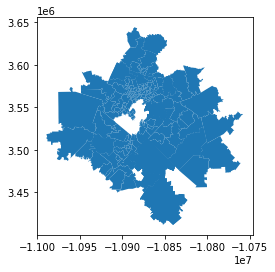

In [23]:
sabs_shp_osm[sabs_shp_osm['ncessch'].isin(ix_keys)].plot()

<AxesSubplot:>

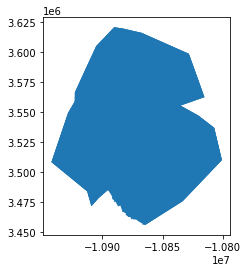

In [24]:
msa_shp_osm.plot()

<AxesSubplot:>

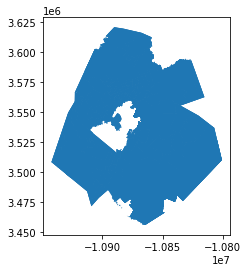

In [28]:
gpd.overlay(msa_shp_osm, sabs_shp_osm, how="intersection").plot()

I'm not the most experienced with `geopandas.overlay`, so I'll recapitulate below to double check:

<AxesSubplot:>

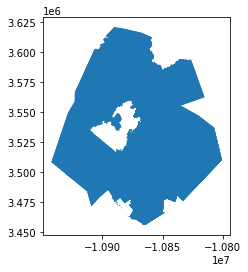

In [27]:
gpd.overlay(sabs_shp_osm[sabs_shp_osm['ncessch'].isin(ix_keys)], msa_shp_osm, how="intersection").plot()


## Intersection Calculation

Calculate the area within each polygon:

In [40]:
es_shp_osm['es_area'] = es_shp_osm.area
atx_shp_osm['cbg_area'] = atx_shp_osm.area

Overlay the two polygons:

In [41]:
es_atx = gpd.overlay(atx_shp_osm, es_shp_osm, how='intersection')

<AxesSubplot:>

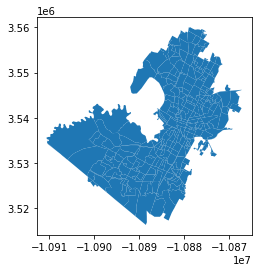

In [42]:
es_atx.plot()

Calculate overlap area and percent overlap:

In [9]:
es_atx['overlap_area'] = es_atx.area
# what percent of an elementary catchment corresponds to the underlying CBG?
es_atx['pct_overlap'] = (es_atx['overlap_area'] / es_atx['cbg_area']) * 100

Grab only the columns of interest to save as a CSV (this will ultimately be further transformed into something like `travel.csv` from the toy contact partitioning model):

In [10]:
overlaps = es_atx[['GEOID', 'ISD', 'CAMPUS', 'SCHL_YEAR', 'pct_overlap']]

Add an age level indicator column:

In [11]:
overlaps['level'] = 'elementary'

<ipython-input-11-e32dde511769>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  overlaps['level'] = 'elementary'


Write to file:

In [12]:
overlaps.to_csv('AISD_elem_census_tract_overlaps.csv')